# Q3

## Mounting GDrive

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Imports

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms
import os

## Selecting Device

In [3]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

Using device: cuda


## Loading Model and freezing weights

In [4]:
model = models.vgg19(weights='DEFAULT').features.to(device).eval()
for param in model.parameters():
    param.requires_grad_(False)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:07<00:00, 76.4MB/s]


## Attaching hooks to the first five conv2d layers

In [5]:
activations = []

def save_activation(module, input, output):
    activations.append(output)

# Identify content and style layers
content_layer_idx = 3  # 4th layer
n_style_layers = 5      # First 5 conv layers

# Hook the first five convolutional layers
conv_counter = 0
hooks = []
for layer in model.children():
    if isinstance(layer, nn.Conv2d):
        hooks.append(layer.register_forward_hook(save_activation))
        conv_counter += 1
        if conv_counter == n_style_layers:
            break

## Function for reading and preprocessing images

In [6]:
def read_image(image_path):
    preprocess = transforms.Compose([
        transforms.Resize((224, 224)),  # Resize to match VGG input
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

    img = Image.open(image_path).convert("RGB")
    img = preprocess(img).unsqueeze(0).to(device)

    return img

## 3.1

## Defining Loss Functions

In [ ]:
# Content loss function
def content_loss(input_features, target_features):
    return torch.mean((input_features - target_features) ** 2)

# Gram matrix function for style loss
def gram_matrix(features):
    batch_size, channels, height, width = features.size()
    features = features.view(channels, height * width)
    gram = torch.mm(features, features.t())
    return gram.div(channels * height * width)  # Normalize

# Style loss function
def style_loss(input_features, target_features):
    input_gram = gram_matrix(input_features)
    target_gram = gram_matrix(target_features)
    return F.mse_loss(input_gram, target_gram)

# Calculate content and style losses
def calculate_losses(content_img, generated_img, style_img, model):
    _ = model(generated_img)
    gen_features = [f.to(device) for f in activations]
    activations.clear()
    
    _ = model(content_img)
    content_features = [f.to(device) for f in activations]
    activations.clear()

    # Content loss
    content_loss_value = content_loss(gen_features[content_layer_idx], content_features[content_layer_idx])

    # Style loss
    weight_per_layer = 1.0 / n_style_layers
    style_loss_value = 0
    for gen_feat, style_gram in zip(gen_features, style_grams):
        current_gram = gram_matrix(gen_feat)
        style_loss_value += F.mse_loss(current_gram, style_gram) * weight_per_layer

    return content_loss_value, style_loss_value

## 3.2

## Function for style transfer

In [ ]:
def transfer_style(content_img, style_img, model, alpha, beta, num_steps, lr, optimizer):
    generated_img = torch.rand_like(content_img, device=device).requires_grad_(True)  # White noise image on device
    if optimizer == 'LBFGS':
        optimizer = optim.LBFGS([generated_img], lr=lr)
    elif optimizer == 'Adam':
        optimizer = optim.Adam([generated_img], lr=lr)

    loss_arr = list()

    def closure():
        optimizer.zero_grad()
        loss_c, loss_s = calculate_losses(content_img, generated_img, style_img, model)
        loss = alpha * loss_c + beta * loss_s
        loss_arr.append(loss.item())
        loss.backward()
        return loss

    for step in range(num_steps):
        # print(f"Step {step + 1}/{num_steps}")
        optimizer.step(closure)

    return generated_img, loss_arr

## Function to display final outputs

In [9]:
# Display image function
def imshow(tensors, titles, loss_arr, alpha, beta, optimizer, save_as):
    images = [unnormalize(t.cpu().clone().squeeze(0)).detach().numpy() for t in tensors]
    fig, ax = plt.subplots(1, 4, figsize=(20, 5))
    for i in range(len(images)):
        ax[i].imshow(np.transpose(images[i], (1, 2, 0)))
        ax[i].axis('off')
        ax[i].set_title(titles[i])
    ax[-1].plot(loss_arr)
    ax[-1].set_xlabel('Iterations')
    ax[-1].set_ylabel('Loss')
    plt.suptitle(f"Alpha = {alpha}, Beta = {beta}, Optimizer = {optimizer}")
    plt.tight_layout()
    plt.savefig(save_as, bbox_inches='tight', dpi=300)
    plt.show()
    print(f"Saved image at {save_as}")

# Unnormalize function (Since we normalised the image before passing it into the model)
def unnormalize(tensor):
    mean = torch.tensor([0.485, 0.456, 0.406], device=tensor.device).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225], device=tensor.device).view(3, 1, 1)

    unnormalized = tensor * std + mean  # Out-of-place operation
    return torch.clamp(unnormalized, 0, 1)  # Clamp to [0,1]

## Hyperparameters and Images

In [10]:
alpha_beta_values = [
    (1e5, 1e10),  # Default
    (1e4, 1e8),   # More content retention
    (5e4, 5e9),   # Balanced
    (1e6, 1e11),  # More style effect
    (1e5, 1e9)    # Slightly more content influence
]

n_steps = 5
lr = 1

content_imgs_dir = '/content/drive/MyDrive/cv_a2/q3/dataset/content/'
style_imgs_dir = '/content/drive/MyDrive/cv_a2/q3/dataset/styles/'
output_imgs_dir = '/content/drive/MyDrive/cv_a2/q3/outputs'

def get_image_paths(directory):
    image_paths = []
    for filename in os.listdir(directory):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            image_paths.append(os.path.join(directory, filename))
    return image_paths

content_imgs_path = get_image_paths(content_imgs_dir)
style_imgs_path = get_image_paths(style_imgs_dir)

content_imgs = [read_image(img_path) for img_path in content_imgs_path]
style_imgs = [read_image(img_path) for img_path in style_imgs_path]

print(f"Number of content images = {len(content_imgs)}")
print(f"Number of style images = {len(style_imgs)}")
print()

Number of content images = 10
Number of style images = 10



## Main loop for generating all the combinations (LBFGS)

Beginning with style transfer for image 1, alpha = 1000000.0, beta = 100000000000.0, optimizer = LBFGS


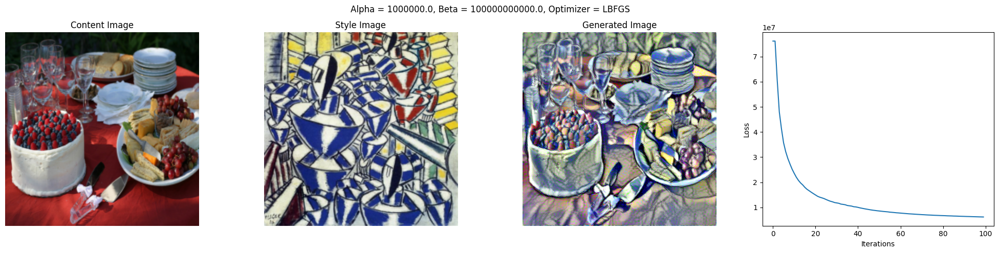

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/0_1000000.0_100000000000.0.jpg




Beginning with style transfer for image 2, alpha = 100000.0, beta = 10000000000.0, optimizer = LBFGS


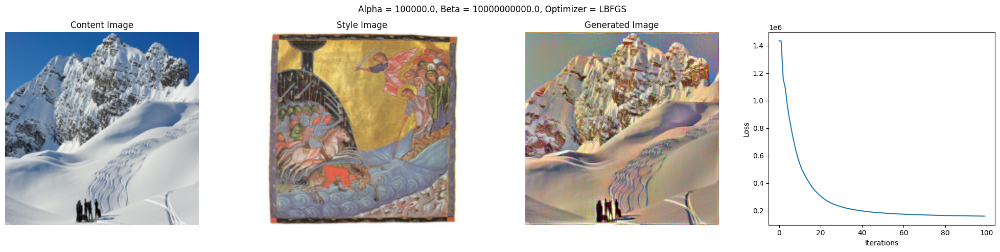

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/1_100000.0_10000000000.0.jpg




Beginning with style transfer for image 3, alpha = 1000000.0, beta = 100000000000.0, optimizer = LBFGS


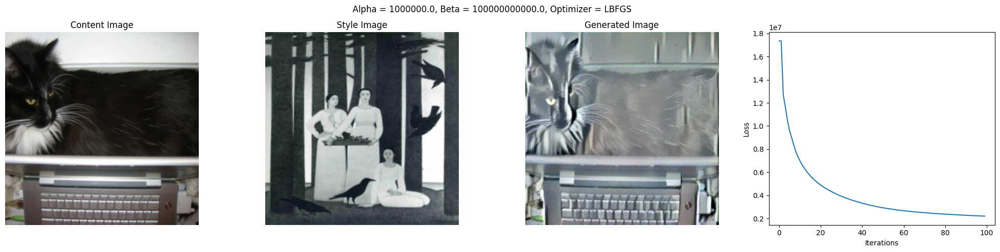

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/2_1000000.0_100000000000.0.jpg




Beginning with style transfer for image 4, alpha = 1000000.0, beta = 100000000000.0, optimizer = LBFGS


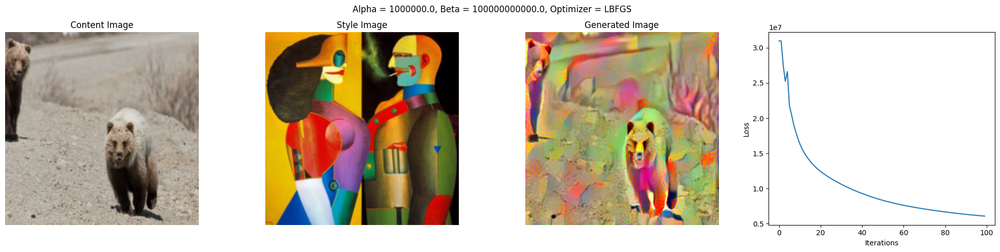

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/3_1000000.0_100000000000.0.jpg




Beginning with style transfer for image 5, alpha = 1000000.0, beta = 100000000000.0, optimizer = LBFGS


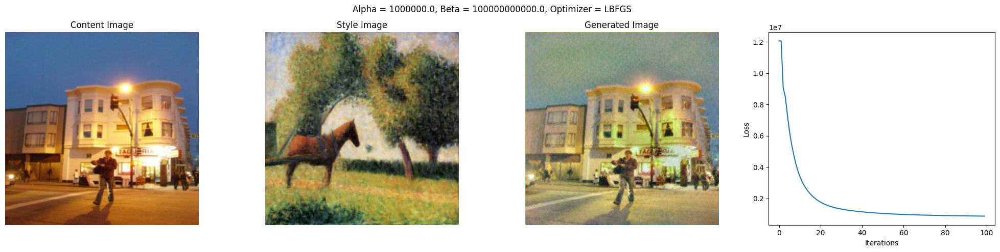

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/4_1000000.0_100000000000.0.jpg




Beginning with style transfer for image 6, alpha = 100000.0, beta = 1000000000.0, optimizer = LBFGS


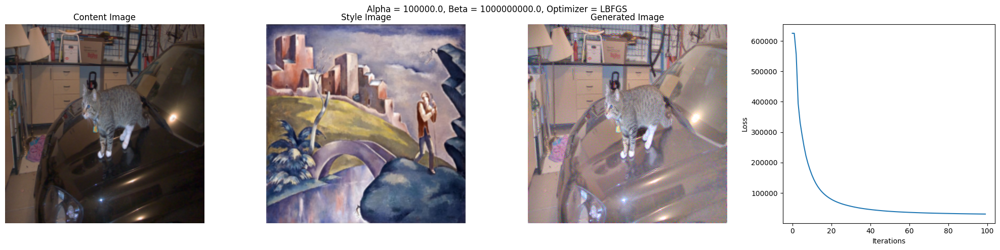

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/5_100000.0_1000000000.0.jpg




Beginning with style transfer for image 7, alpha = 100000.0, beta = 10000000000.0, optimizer = LBFGS


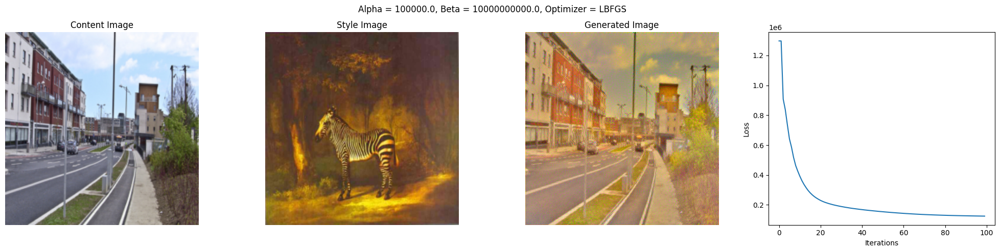

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/6_100000.0_10000000000.0.jpg




Beginning with style transfer for image 8, alpha = 100000.0, beta = 1000000000.0, optimizer = LBFGS


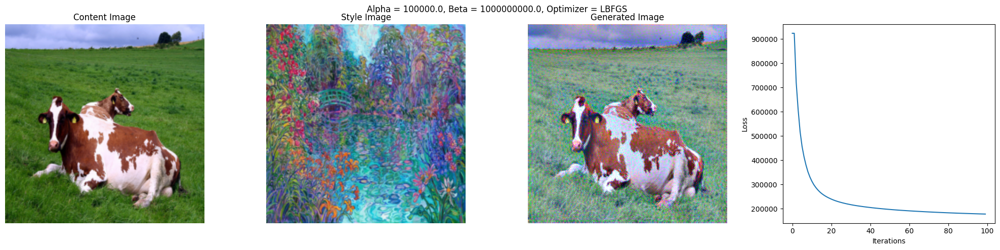

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/7_100000.0_1000000000.0.jpg




Beginning with style transfer for image 9, alpha = 10000.0, beta = 100000000.0, optimizer = LBFGS


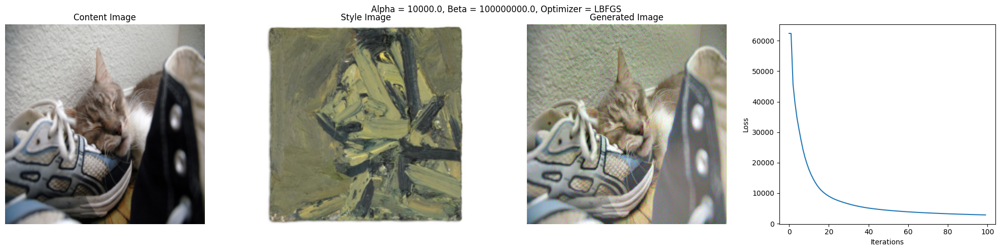

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/8_10000.0_100000000.0.jpg




Beginning with style transfer for image 10, alpha = 1000000.0, beta = 100000000000.0, optimizer = LBFGS


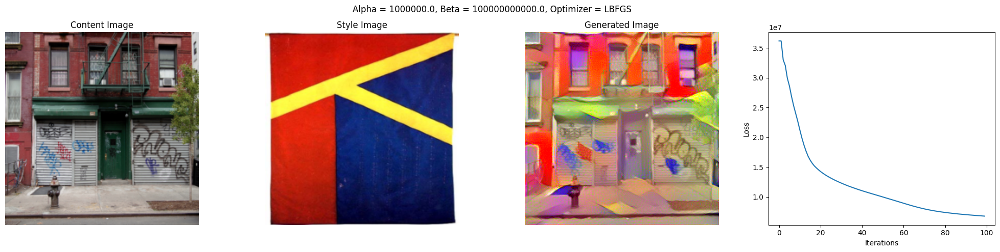

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/9_1000000.0_100000000000.0.jpg






In [11]:
idx = 0

for content_img, style_img in zip(content_imgs, style_imgs):
    # Selecting some random alpha, beta value
    random_idx = np.random.randint(0, len(alpha_beta_values))
    alpha, beta = alpha_beta_values[random_idx]

    # Get content features
    _ = model(content_img)
    content_features = [f.to(device) for f in activations]  # Move to device
    activations.clear()

    # Get style features and their Gram matrices
    _ = model(style_img)
    style_features = [f.to(device) for f in activations]  # Move to device
    activations.clear()
    style_grams = [gram_matrix(feature) for feature in style_features]

    # Run style transfer
    print(f"Beginning with style transfer for image {idx + 1}, alpha = {alpha}, beta = {beta}, optimizer = LBFGS")
    generated_img, loss_arr = transfer_style(content_img, style_img, model, alpha, beta, n_steps, lr, "LBFGS")

    # Display images
    titles = ['Content Image', 'Style Image', 'Generated Image']
    tensors = [content_img, style_img, generated_img]
    imshow(tensors, titles, loss_arr, alpha, beta, "LBFGS", output_imgs_dir + f"/{idx}_{alpha}_{beta}.jpg")
    print("\n\n\n")

    idx += 1

## Main loop for generating all the combinations (Adam)

Beginning with style transfer for image 1, alpha = 50000.0, beta = 5000000000.0, optimizer = Adam


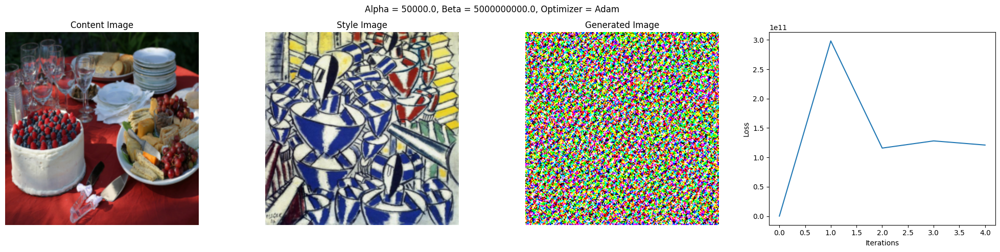

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/0_50000.0_5000000000.0.jpg




Beginning with style transfer for image 2, alpha = 100000.0, beta = 10000000000.0, optimizer = Adam


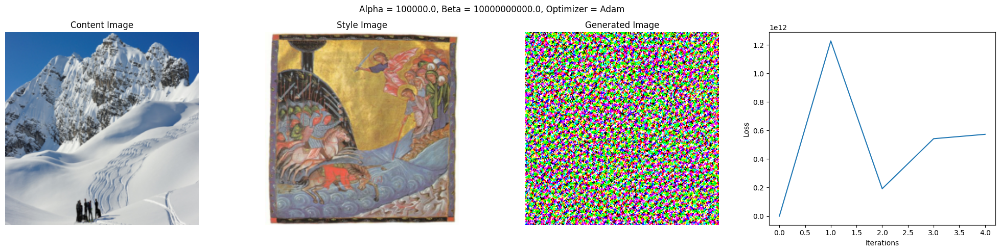

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/1_100000.0_10000000000.0.jpg




Beginning with style transfer for image 3, alpha = 100000.0, beta = 10000000000.0, optimizer = Adam


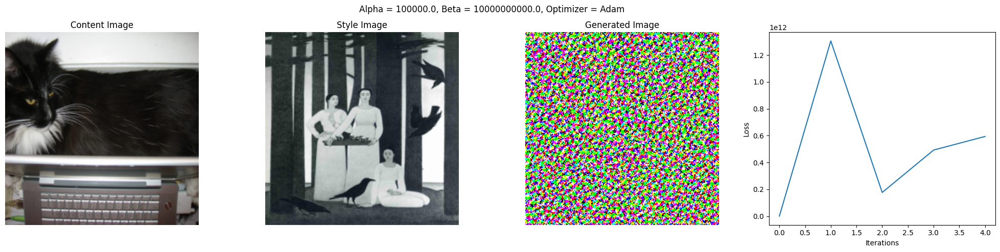

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/2_100000.0_10000000000.0.jpg




Beginning with style transfer for image 4, alpha = 100000.0, beta = 1000000000.0, optimizer = Adam


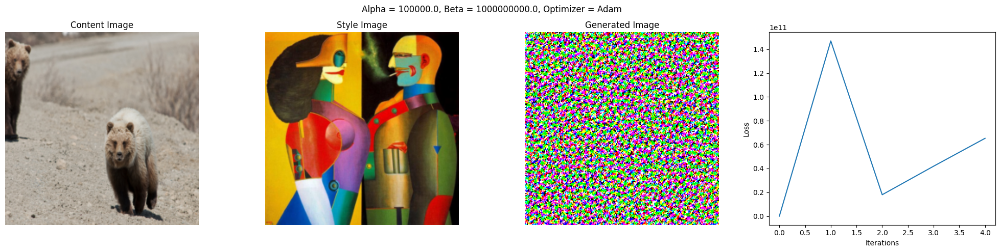

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/3_100000.0_1000000000.0.jpg




Beginning with style transfer for image 5, alpha = 100000.0, beta = 10000000000.0, optimizer = Adam


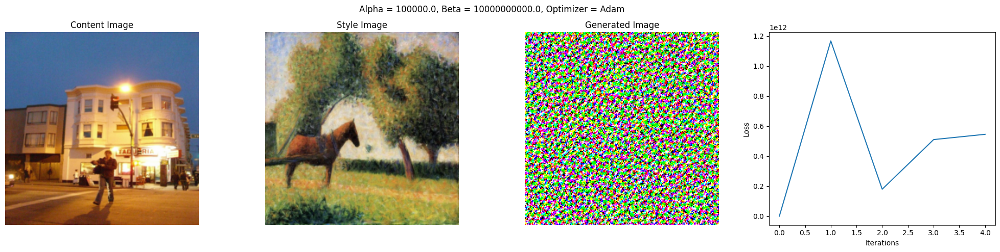

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/4_100000.0_10000000000.0.jpg




Beginning with style transfer for image 6, alpha = 1000000.0, beta = 100000000000.0, optimizer = Adam


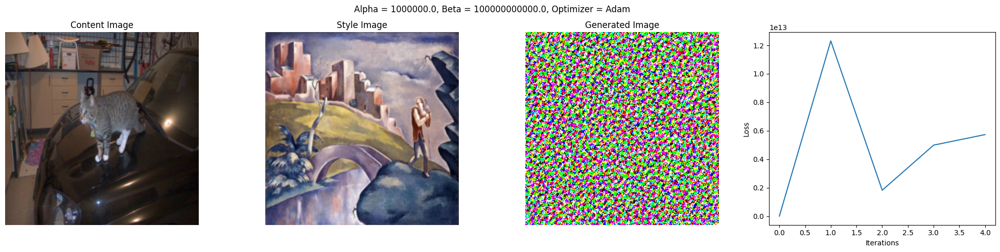

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/5_1000000.0_100000000000.0.jpg




Beginning with style transfer for image 7, alpha = 100000.0, beta = 1000000000.0, optimizer = Adam


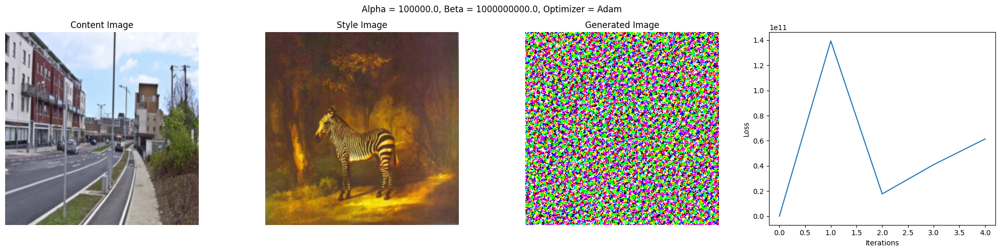

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/6_100000.0_1000000000.0.jpg




Beginning with style transfer for image 8, alpha = 10000.0, beta = 100000000.0, optimizer = Adam


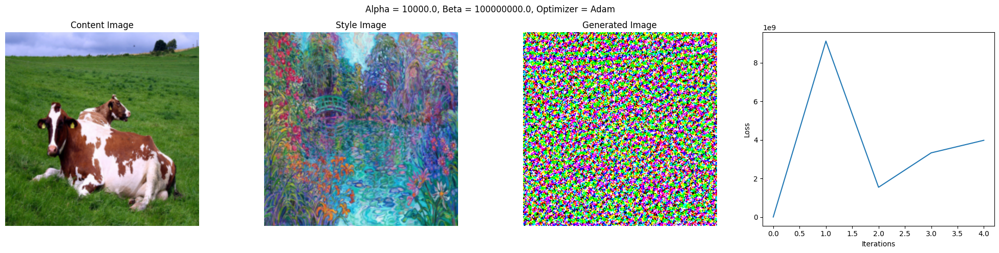

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/7_10000.0_100000000.0.jpg




Beginning with style transfer for image 9, alpha = 1000000.0, beta = 100000000000.0, optimizer = Adam


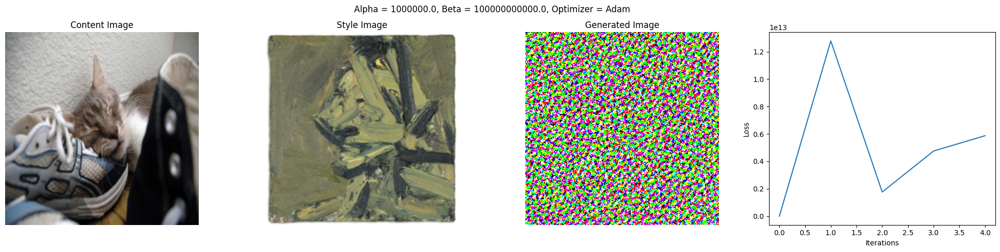

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/8_1000000.0_100000000000.0.jpg




Beginning with style transfer for image 10, alpha = 10000.0, beta = 100000000.0, optimizer = Adam


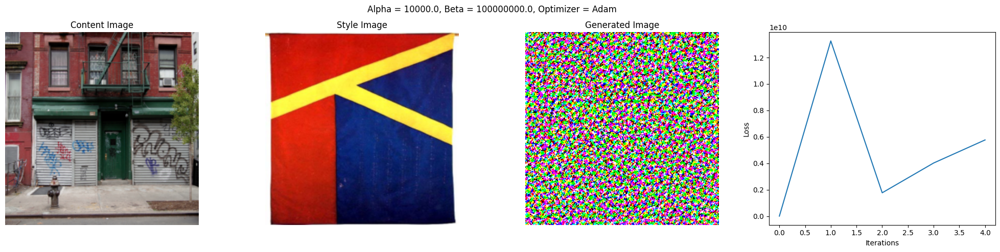

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/9_10000.0_100000000.0.jpg






In [12]:
idx = 0
n_steps = 300

for content_img, style_img in zip(content_imgs, style_imgs):
    # Selecting some random alpha, beta value
    random_idx = np.random.randint(0, len(alpha_beta_values))
    alpha, beta = alpha_beta_values[random_idx]

    # Get content features
    _ = model(content_img)
    content_features = [f.to(device) for f in activations]  # Move to device
    activations.clear()

    # Get style features and their Gram matrices
    _ = model(style_img)
    style_features = [f.to(device) for f in activations]  # Move to device
    activations.clear()
    style_grams = [gram_matrix(feature) for feature in style_features]

    # Run style transfer
    print(f"Beginning with style transfer for image {idx + 1}, alpha = {alpha}, beta = {beta}, optimizer = Adam")
    generated_img, loss_arr = transfer_style(content_img, style_img, model, alpha, beta, n_steps, lr, "Adam")

    # Display images
    titles = ['Content Image', 'Style Image', 'Generated Image']
    tensors = [content_img, style_img, generated_img]
    imshow(tensors, titles, loss_arr, alpha, beta, "Adam", output_imgs_dir + f"/{idx}_{alpha}_{beta}.jpg")
    print("\n\n\n")

    idx += 1

## Applying custom style to my image

Beginning with style transfer for my image, alpha = 10000.0, beta = 1000000000.0, optimizer = LBFGS


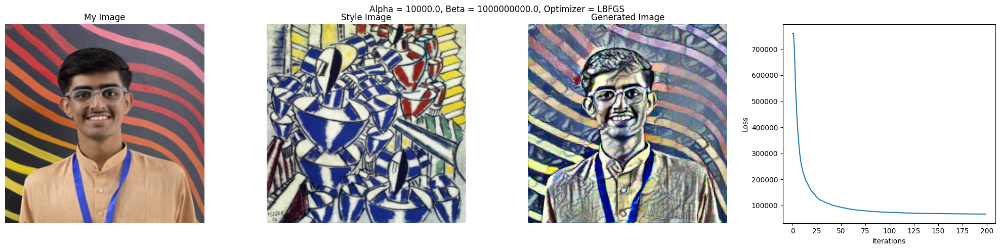

Saved image at /content/drive/MyDrive/cv_a2/q3/outputs/my_img.jpg


In [13]:
content_img = read_image("/content/drive/MyDrive/cv_a2/q3/dataset/vinit.jpg")
style_img = read_image("/content/drive/MyDrive/cv_a2/q3/dataset/styles/the-exit-of-the-russian-ballet.jpg")

n_steps = 10
lr = 1

alpha = 1e4
beta = 1e9

# Get content features
_ = model(content_img)
content_features = [f.to(device) for f in activations]  # Move to device
activations.clear()

# Get style features and their Gram matrices
_ = model(style_img)
style_features = [f.to(device) for f in activations]  # Move to device
activations.clear()
style_grams = [gram_matrix(feature) for feature in style_features]

# Run style transfer
print(f"Beginning with style transfer for my image, alpha = {alpha}, beta = {beta}, optimizer = LBFGS")
generated_img, loss_arr = transfer_style(content_img, style_img, model, alpha, beta, n_steps, lr, "LBFGS")

# Display images
titles = ['My Image', 'Style Image', 'Generated Image']
tensors = [content_img, style_img, generated_img]
imshow(tensors, titles, loss_arr, alpha, beta, "LBFGS", "/content/drive/MyDrive/cv_a2/q3/outputs/my_img.jpg")

>  It works well for paintings, landscapes, and abstract art but struggles with preserving fine details, extreme style-content mismatches, and photorealistic style transfer. The balance between content and style can be adjusted via hyperparameters, but excessive stylization can distort recognizable structures. While effective, the approach is computationally expensive due to its optimization-based nature. Future improvements should focus on real-time processing, better detail preservation, and enhanced control over content-style blending.